# Projet 4 : Segmentez des clients d'un site de e-commerce
## Notebook de nettoyage et d'exploration de la base de données
Ce notebook contient les essais de clustering avec différents algorithmes

### Contexte et objectifs
L'entreprise de e-commerce Olist souhaite comprendre les différents types de clients qu'elle possède. Elle souhaite donc ségmenter sa clientèle afin de pouvoir mieux communiquer en fonction du type de client. Pour cela elle souhaite classer les clients en fonction de leurs commandes passées ainsi que la satisfaction. 

### Modules Python

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import timedelta
from sklearn import preprocessing, metrics, cluster, decomposition
from sklearn.cluster import AgglomerativeClustering, KMeans, DBSCAN
import scipy.cluster.hierarchy as shc
import plotly.express as px
from plotly.subplots import make_subplots

### fonctions utiles

In [2]:
def display_scree_plot(pca):
    scree = pca.explained_variance_ratio_*100
    plt.bar(np.arange(len(scree))+1, scree)
    plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
    plt.xlabel("rang de l'axe d'inertie")
    plt.ylabel("pourcentage d'inertie")
    plt.title("Eboulis des valeurs propres")
    plt.show(block=False)

In [3]:
def display_circles(pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None):
    """
    extracted from OC courses 
    """
    for d1, d2 in axis_ranks: # On affiche les 3 premiers plans factoriels, donc les 6 premières composantes
        if d2 < n_comp:

            # initialisation de la figure
            fig, ax = plt.subplots(figsize=(7,6))

            # détermination des limites du graphique
            if lims is not None :
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30 :
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else :
                xmin, xmax, ymin, ymax = min(pcs[d1,:]), max(pcs[d1,:]), min(pcs[d2,:]), max(pcs[d2,:])

            # affichage des flèches
            # s'il y a plus de 30 flèches, on n'affiche pas le triangle à leur extrémité
            if pcs.shape[1] < 30 :
                plt.quiver(np.zeros(pcs.shape[1]), np.zeros(pcs.shape[1]),
                   pcs[d1,:], pcs[d2,:], 
                   angles='xy', scale_units='xy', scale=1, color="grey")
                # (voir la doc : https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html)
            else:
                lines = [[[0,0],[x,y]] for x,y in pcs[[d1,d2]].T]
                ax.add_collection(LineCollection(lines, axes=ax, alpha=.1, color='black'))
            
            # affichage des noms des variables  
            if labels is not None:  
                for i,(x, y) in enumerate(pcs[[d1,d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax :
                        plt.text(x, y, labels[i], fontsize='14', ha='center', va='center', rotation=label_rotation, color="blue", alpha=0.5)
            
            # affichage du cercle
            circle = plt.Circle((0,0), 1, facecolor='none', edgecolor='b')
            plt.gca().add_artist(circle)

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)
        
    
            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-1, 1], color='grey', ls='--')

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('F{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('F{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("Cercle des corrélations (F{} et F{})".format(d1+1, d2+1))
            plt.show(block=False)

### Chargement du dataset

In [4]:
DATA = pd.read_csv("database_merge_cleaned.csv",sep=",", skipinitialspace=True, low_memory=False,\
                  parse_dates=[8], dayfirst=False)
print(f"Nombre de lignes : {len(DATA)}")
print(f"Nombre de variables : {len(DATA.columns)}")
print("Type des variables :")
print(DATA.dtypes)

Nombre de lignes : 111708
Nombre de variables : 14
Type des variables :
customer_id                         object
customer_unique_id                  object
customer_zip_code_prefix             int64
customer_city                       object
customer_state                      object
geolocation_lat                    float64
geolocation_lng                    float64
order_id                            object
order_purchase_timestamp    datetime64[ns]
review_score                       float64
order_item_id                      float64
product_id                          object
price                              float64
product_category_name               object
dtype: object


In [5]:
print(f"Date de la première commande : {DATA['order_purchase_timestamp'].min()}")
print(f"Date de la dernière commande : {DATA['order_purchase_timestamp'].max()}")
print(f"Temps entre la première et la dernière commande : {DATA['order_purchase_timestamp'].max()-DATA['order_purchase_timestamp'].min()}")

Date de la première commande : 2016-09-04 21:15:19
Date de la dernière commande : 2018-09-03 09:06:57
Temps entre la première et la dernière commande : 728 days 11:51:38


Les données regroupent les commandes de deux ans environ.  
La segmentation sera donc effectuée sur cette période.

#### Selection d'une période
On sélectionne les données sur une période de deux ans à partir de la première commande pour réaliser les essais de clusterisations.  
Pour cela on créé une base de données contenant uniquement les données sur cette période.

In [6]:
# START = DATA['order_purchase_timestamp'].min().date()
# END = DATA['order_purchase_timestamp'].min().date() + timedelta(days=365*2)
# print(f"Premier jour de la base de données : {START}")
# print(f"Dernier jour de la base de données : {END}")
# date = DATA['order_purchase_timestamp'].apply(lambda x :x.date())
# DATA_2ans = DATA[(date >= START) & (date<= END)]
# print(f"Nombre de lignes utilisées : {len(DATA_2ans)}")

#### selection des clients avec plus de 1 commande
Compte tenu de la taille de la base de données, il n'est pas possible d'utiliser la fonction linkage ou AgglomerativeClustering.  
En effet, le besoin en mémoire est trop important. De ce fait, la segmentation est réalisée uniquement sur les clients avec plus de 1 commande.

In [7]:
norder = DATA.groupby("customer_unique_id").agg({"order_id": lambda x : len(x.unique())})

In [8]:
cust_id = norder[norder["order_id"]>1].index.values

In [9]:
data_small = DATA[DATA["customer_unique_id"].isin(cust_id)]

In [10]:
print(f"Nombre de clients dans la base de données : {len(data_small['customer_unique_id'].unique())}")
START = data_small['order_purchase_timestamp'].min().date()
print(f"Date de la première commande : {START}")
END = data_small['order_purchase_timestamp'].max().date()
print(f"Date de la dernière commande : {END}")
print(f"Temps entre la première et la dernière commande : {END-START}")

Nombre de clients dans la base de données : 2869
Date de la première commande : 2016-10-03
Date de la dernière commande : 2018-09-03
Temps entre la première et la dernière commande : 700 days, 0:00:00


### RFM

#### Ajout de variables pour calculer le RFM :
- Nombre de jour depuis la commande : "ndays_orders"

In [11]:
data_small['days_orders'] = data_small["order_purchase_timestamp"].apply(lambda x : (END-x.date()).days)

C:\Users\erwan\AppData\Local\Temp/ipykernel_12496/2905017795.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_small['days_orders'] = data_small["order_purchase_timestamp"].apply(lambda x : (END-x.date()).days)


#### Calcul des variables Recency, Frequency et Monetary :
- Recency : nombre de jours depuis la dernière commande
- Frequency : nombre de commandes sur la période
-  Monetary : argent dépensé sur la période

In [12]:
aggr = {
    'days_orders' : lambda x : x.min(), #nombre de jour depuis la dernière commande
    'order_id' : lambda x : len(x.unique()), #Nombre de commande sur la période
    'price' :lambda x : x.sum() #montant dépensé
}

In [13]:
rfm = data_small.groupby("customer_unique_id").agg(aggr)
rfm.rename(columns={"days_orders" : "recency", "order_id": "frequency", "price" : "monetary"}, inplace=True)
rfm

,recency,frequency,monetary
customer_unique_id,,,
004288347e5e88a27ded2bb23747066c,232,2,317.89
004b45ec5c64187465168251cd1c9c2f,100,2,86.90
0058f300f57d7b93c477a131a59b36c3,165,2,132.48
00a39521eb40f7012db50455bf083460,92,2,81.45
00cc12a6d8b578b8ebd21ea4e2ae8b27,531,2,99.80
...,...,...,...
ff22e30958c13ffe219db7d711e8f564,0,2,290.00
ff44401d0d8f5b9c54a47374eb48c1b8,472,2,39.80
ff8892f7c26aa0446da53d01b18df463,281,2,277.95


#### Creation du score RFM
Création d'un score entre 1 et 5 en fonction des quantiles.
Les valeurs proches de 5 sont les meilleurs clients, ceux proches de 1 les moins bons.

In [14]:
rfm['frequency'].value_counts()

2     2635
3      186
4       29
5        9
6        5
7        3
9        1
16       1
Name: frequency, dtype: int64

In [15]:
quant = rfm[['recency', 'frequency', 'monetary']].quantile([.2, .4, .6, .8])
quant

,recency,frequency,monetary
0.2,88.0,2.0,98.060
0.4,169.0,2.0,153.816
0.6,250.0,2.0,221.972
0.8,358.0,2.0,349.900


L'utilisation de quantiles pour la fréquence n'est pas adaptée : la majorité des clients a passé 2 commandes.  
le score F sera donc le nombre de commandes - 1. Pour garder les données entre 1 et 5, les clients ayant commandés plus de 6 fois aura un score de 5.

In [16]:
def r_score(x, quantiles):
    if x <= quantiles[.2]:
        return 5
    elif x <= quantiles[.4]:
        return 4
    elif x <= quantiles[.6]:
        return 3
    elif x <= quantiles[.8]:
        return 2
    else:
        return 1
    
def m_score(x, quantiles) :
    if x <= quantiles[.2]:
        return 1
    elif x <= quantiles[.4]:
        return 2
    elif x <= quantiles[.6]:
        return 3
    elif x <= quantiles[.8]:
        return 4
    else:
        return 5    
def f_score(x) :
    if x > 6 :
        return 5
    else :
        return x-1

In [17]:
rfm["R"] = rfm['recency'].apply(lambda x : r_score(x, quant['recency']))
rfm["F"] = rfm['frequency'].apply(lambda x : f_score(x))
rfm["M"] = rfm['monetary'].apply(lambda x : m_score(x, quant['monetary']))
rfm

,recency,frequency,monetary,R,F,M
customer_unique_id,,,,,,
004288347e5e88a27ded2bb23747066c,232,2,317.89,3,1,4
004b45ec5c64187465168251cd1c9c2f,100,2,86.90,4,1,1
0058f300f57d7b93c477a131a59b36c3,165,2,132.48,4,1,2
00a39521eb40f7012db50455bf083460,92,2,81.45,4,1,1
00cc12a6d8b578b8ebd21ea4e2ae8b27,531,2,99.80,1,1,2
...,...,...,...,...,...,...
ff22e30958c13ffe219db7d711e8f564,0,2,290.00,5,1,4
ff44401d0d8f5b9c54a47374eb48c1b8,472,2,39.80,1,1,1
ff8892f7c26aa0446da53d01b18df463,281,2,277.95,2,1,4


In [18]:
rfm['RFM_label'] = rfm.agg(lambda x :f"{int(x['R'])}{int(x['F'])}{int(x['M'])}", axis=1)
rfm['RFM_score'] = rfm[["R", 'F','M']].sum(axis=1)

#### segmentation
On peut segmenter les clients à partir du RFM_score.  
De manière arbitraire et sans connaissance du domaine, on peut créer 3 catégories :
- mauvais client : RFM_score < 5
- bon client : RFM_score >=5 et RFM_score < 10
- très bon client : RFM_score >= 10

In [19]:
def rfm_seg(x) :
    if x < 5 :
        return "bad"
    elif x < 10 :
        return "good"
    else :
        return "very good"

In [20]:
rfm["segment"] = rfm['RFM_score'].apply(rfm_seg)

In [21]:
print(f"Nombre de mauvais clients = {len(rfm[rfm['segment']=='bad'])} soit {len(rfm[rfm['segment']=='bad'])/len(rfm)*100}%")
print(f"Nombre de bon clients = {len(rfm[rfm['segment']=='good'])} soit {len(rfm[rfm['segment']=='good'])/len(rfm)*100}%")
print(f"Nombre de très bon clients = {len(rfm[rfm['segment']=='very good'])} soit {len(rfm[rfm['segment']=='very good'])/len(rfm)*100}%")


Nombre de mauvais clients = 377 soit 13.14046706169397%
Nombre de bon clients = 2075 soit 72.32485186476124%
Nombre de très bon clients = 417 soit 14.534681073544789%


Cette segmentation a l'inconvénient de classer la majorité des clients dans le segment "bon"

#### Visualisation de la clusterisation
##### Distribution des valeurs R F et M en fonction du segment

segment = bad


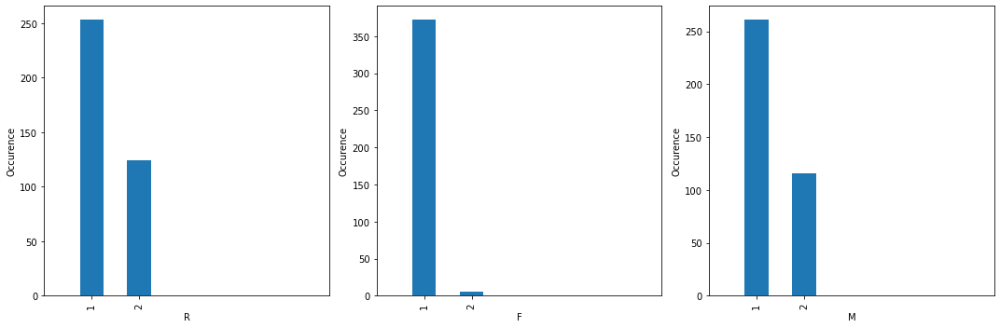

segment = good


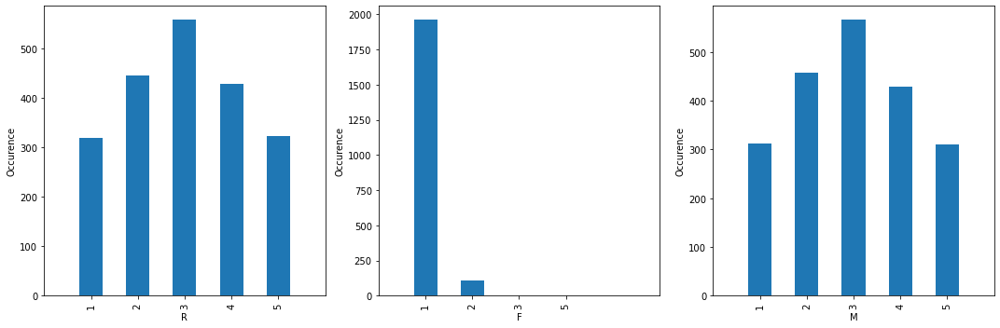

segment = very good


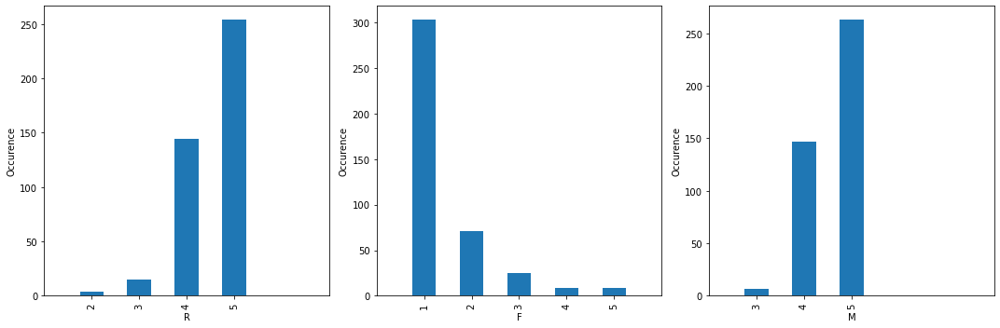

In [22]:
for seg in ['bad', 'good', 'very good'] :
    print("="*50)
    print("segment = "+seg)
    print("="*50)
    fig, axs = plt.subplots(ncols=3, nrows=1, figsize=(15,5))
    for i, par in enumerate(['R', 'F','M']) :
        counts = rfm[rfm['segment'] == seg][par].value_counts().sort_index()
        counts.plot(kind='bar',ax=axs[i])
        axs[i].set_ylabel("Occurence")
        axs[i].set_xlabel(par)
        axs[i].set_xlim((-1,5))
    fig.tight_layout()
    plt.show()

La valeur de F n'évolue que peu entre chaque catégorie, peu de clients commandent régulièrement.  
Les valeurs de R et M augmentent plus le client est un bon client.  
On peut visualiser cela sur le plan (R,M)

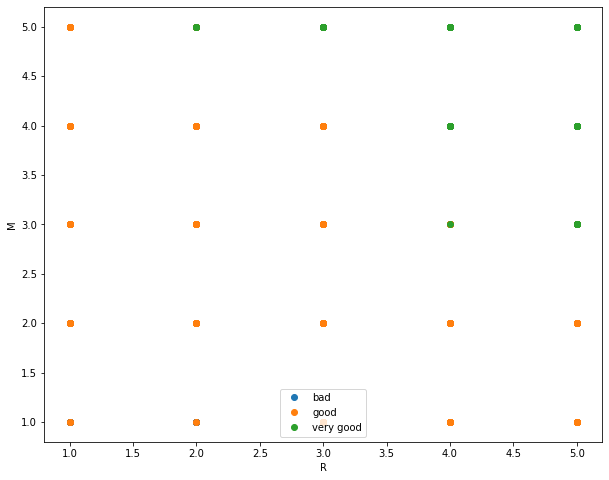

In [23]:
fig, ax = plt.subplots(figsize=((10,8)))
for seg in ['bad', 'good', 'very good'] :
    ax.plot(rfm[rfm['segment']==seg]['R'], rfm[rfm['segment']==seg]['M'], linestyle="", marker="o", label=seg)
ax.set_xlabel("R")
ax.set_ylabel('M')
plt.legend()
plt.show()

Sur cette représentation, les mauvais clients ne sont pas visible, les points sont situés sous les bons clients.

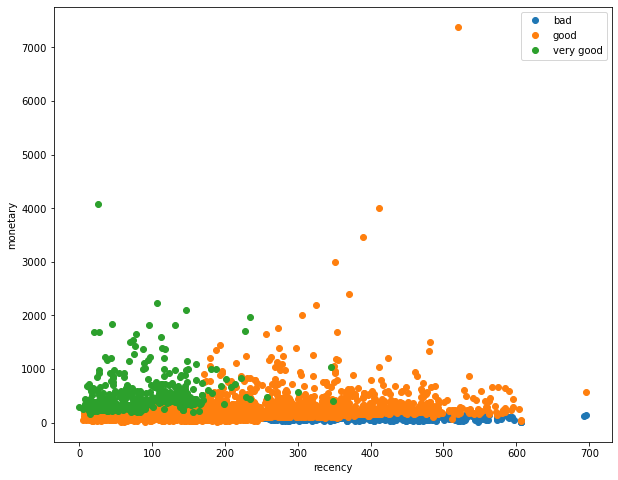

In [24]:
fig, ax = plt.subplots(figsize=((10,8)))
for seg in ['bad', 'good', 'very good'] :
    ax.plot(rfm[rfm['segment']==seg]['recency'], rfm[rfm['segment']==seg]['monetary'], linestyle="", marker="o", label=seg)
ax.set_xlabel("recency")
ax.set_ylabel("monetary")
plt.legend()
plt.show()

On peut représenter les données en 3D, dans l'espace monetary/recency/frequency 

In [70]:
fig = px.scatter_3d(rfm, x='recency', y='monetary', z='frequency', \
                                    color=rfm['segment']) #labels={'x' : "F1", 'y': 'F2', 'z' : 'F3'},title=f"n={n}")       
fig.show()

La visualisation de la segmentation permet d'observer que les mauvais client sont ceux qui commandes rarement et avec un faible montant par commande.  
Les très bon client sont eux des clients commandant très régulièrement.  

#### segmentation à l'aide du K-MEANS
On sélectionne uniquement les colonnes R, F et M.  
Les données sont centrées réduites avant d'effectuer la segmentation.  
On calcule le coefficient de silhouette pour différents nombre de clusters afin de choisir l'optimal.

In [75]:
data = rfm[['R', 'F','M']]

In [76]:
std_scale = preprocessing.StandardScaler().fit(data)
data_norm = std_scale.transform(data)

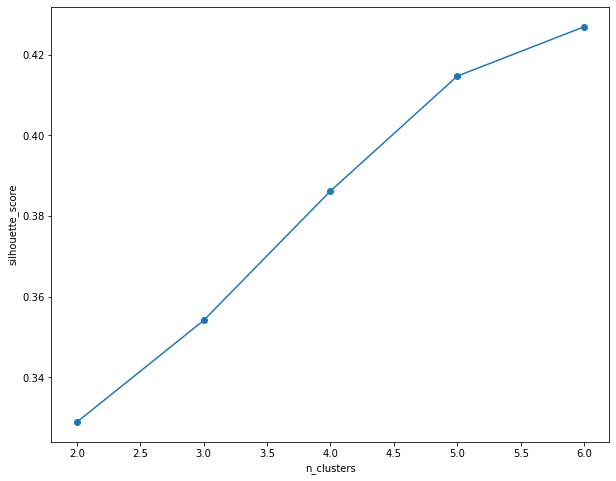

In [77]:
silhouettes = []
for n in range(2,7) : 
    cls = KMeans(n_clusters=n, n_init=5, init='k-means++')
    cls.fit(data_norm)
    silhouettes.append(metrics.silhouette_score(data_norm, cls.labels_))
fig, ax = plt.subplots(figsize=(10,8))
ax.plot(range(2,7), silhouettes, marker='o')
ax.set_xlabel("n_clusters")
ax.set_ylabel('silhouette_score')
plt.show()

Le coefficient de silhouette évolue peu, on choisit donc un nombre de clusters faible pour pouvoir interpréter la segmentation.  
On visualise le résultat pour 3 et 4 clusters.

In [78]:
for n in [3,4] : 
    cls = KMeans(n_clusters=n, n_init=5, init='k-means++')
    cls.fit(data_norm)
    fig = px.scatter_3d(rfm, x='recency', y='monetary', z='frequency', \
                                    color=cls.labels_,title=f"n={n}")       
    fig.show()

Pour 3 clusters :
- Cluster 0 : clients commandant peu et dont la dernière commande date de plus de 200j
- Cluster 1 : clients commandant peu mais avec une dernière commande récente
- Cluster 2 : clients commandant fréquemment

Pour 4 clusters :
- Cluster 0 : clients avec des montants de commandes très faibles
- Cluster 1 : clients avec une faible fréquence de commande et la dernière datant de plus de 200jours
- Cluster 2 : clients commandant peu et dépensant peu
- Cluster 3 : clients commandant peu, mais avec un montant important

Compte tenu de l'interprétation des segmentation, aucun n'est totalement satisfaisant.  
On pourrait fusionner des clusters pour avoir une segmentation de meilleur qualité.  

La segmentation réalisée directement à partir du score RFM est tout autant satisfaisante.



### Préparation de la base de données pour les algorithmes de clusterisation

#### création des données

- nombre de commande
- temps depuis la dernière commande
- montant total 
- prix moyen des articles
- nombre d'article

- montant moyen
- nombre d'article moyen
- satisfaction

In [79]:
aggr = {
    'order_id' : lambda x : len(x.unique()), #Nombre de commande sur la période
    'days_orders' : lambda x : x.min(), #nombre de jour depuis la dernière commande
    'price' : ['sum', 'mean'],
    #'price' :[lambda x : x.sum(), lambda x : x.mean()], # montant total dépensé et montant moyen d'un article
    'product_id' : lambda x : len(x) #Nombre d'articles commandé
}

In [80]:
data = data_small.groupby("customer_unique_id").agg(aggr)
data.rename(columns={"order_id": "n_orders"}, inplace=True)
col = ["n_orders", "n_days_last_order", 'total_price', 'product_mean_price', "n_products"]
data.columns = col

In [81]:
aggr_2 = {
    'price' : 'sum', #montant dépensé par commande
    'product_id': lambda x : len(x), #Nombre de produits par commande
    'review_score' : 'mean' #note par commande
}

In [82]:
data_tmp = data_small.groupby(['customer_unique_id', 'order_id']).agg(aggr_2)

In [83]:
aggr_3 = {
    'price' : 'mean', #prix moyen dépensé par commande
    'product_id': 'mean', #Nombre de produit moyen commandé
    'review_score' : 'mean' #Satisfaction moyenne
}

In [84]:
data_tmp = data_tmp.groupby("customer_unique_id").agg(aggr_3)
data_tmp.columns = ['mean_order_price', 'mean_n_products', 'mean_review_score']

In [85]:
data = pd.concat([data, data_tmp], axis=1)

In [86]:
data

,n_orders,n_days_last_order,total_price,product_mean_price,n_products,mean_order_price,mean_n_products,mean_review_score
customer_unique_id,,,,,,,,
004288347e5e88a27ded2bb23747066c,2,232,317.89,158.945000,2,158.945000,1.0,5.000000
004b45ec5c64187465168251cd1c9c2f,2,100,86.90,43.450000,2,43.450000,1.0,3.000000
0058f300f57d7b93c477a131a59b36c3,2,165,132.48,66.240000,2,66.240000,1.0,3.000000
00a39521eb40f7012db50455bf083460,2,92,81.45,40.725000,2,40.725000,1.0,4.000000
00cc12a6d8b578b8ebd21ea4e2ae8b27,2,531,99.80,49.900000,2,49.900000,1.0,4.000000
...,...,...,...,...,...,...,...,...
ff22e30958c13ffe219db7d711e8f564,2,0,290.00,145.000000,2,145.000000,1.0,1.000000
ff44401d0d8f5b9c54a47374eb48c1b8,2,472,39.80,19.900000,2,19.900000,1.0,3.000000
ff8892f7c26aa0446da53d01b18df463,2,281,277.95,138.975000,2,138.975000,1.0,3.250000


#### normalisation et ACP

In [87]:
std_scale = preprocessing.StandardScaler().fit(data)
data_norm = std_scale.transform(data)
pca = decomposition.PCA(n_components=8)
pca.fit(data_norm)
pcs = pca.components_
data_trans = pca.transform(data_norm)

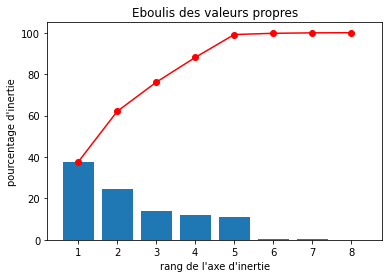

In [88]:
display_scree_plot(pca)

L'ACP montre que les deux premiers axes d'inerties ne captent qu'environ 65% de la variance. Cela signifie qu'en représentant les données sur le plan F1/F2, nous avons une perte importante d'information.  
Il sera préférable de représenter les données dans l'espace F1/F2/F3 pour représenter environ 80% de la variance.

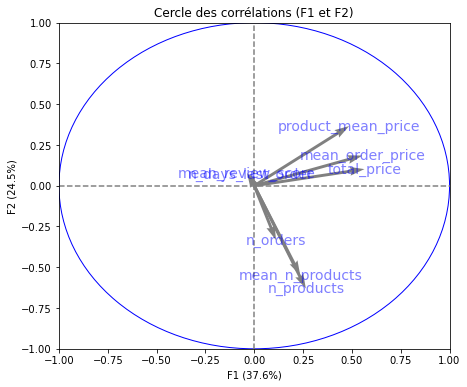

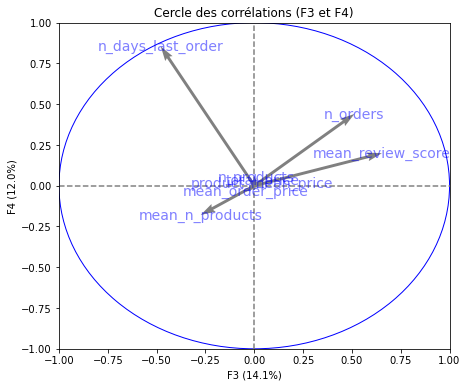

In [89]:
display_circles(pcs, 8, pca, [(0,1), (2,3)], labels = np.array(data.columns))

Le cercle des corrélations montre que l'axe F1 capte en majorité les variables en rapport avec le montant dépensé.  
L'axe F2 capte plutot les variables du nombre de produits commandé et du nombre de commande, soit la fidèlité.  
L'axe F3 capte les variables du nombre de commandes réalisé et de la satisfaction moyenne.  
L'axe F4 capte le nombre de jours depuis la dernière commande.

In [90]:
fig = px.scatter_3d(x=data_trans[:,0], y=data_trans[:,1], z=data_trans[:,2], labels={'x' : "F1", 'y': 'F2', 'z' : 'F3'})       
fig.show()

In [42]:
# fig, ax = plt.subplots(figsize=((10,8)))
# ax.plot(data_trans[:,0], data_trans[:,1], linestyle="", marker="o")
# ax.set_xlabel("F1")
# ax.set_ylabel("F2")
# #plt.legend()
# plt.show()


La représentation des données dans l'espace F1/F2/F3 ne montre pas clairement l'apparition de clusters

### clustering hierarchique

#### Dendrogrammes

In [43]:
Z = shc.linkage(data_norm, method='ward')

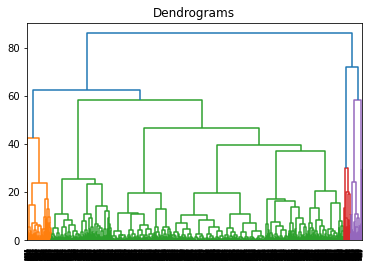

In [44]:
plt.figure()
plt.title("Dendrograms")
dendrogram = shc.dendrogram(Z)
#plt.ylim((20,65))
#plt.axhline(y=38, c="black")
plt.show()

Le dendrogramme montre que notre jeu de données contient maximum 4 clusters, mais qu'un est très fortement dispercé.  
Pour la suite il sera judicieux d'utiliser 3 ou 4 clusters.

#### calcul des clusters
Pour caractériser la clusterisation, on mesure des paramètres :
- Davies Bouldin :  moyenne du rapport maximal entre la distance d'un point au centre de son groupe et la distance entre deux centres de groupes. Cette valeur doit être la plus faible possible
- coefficient de silhouette : différence entre la distance moyenne avec les points du même groupe que lui (cohésion) et la distance moyenne avec les points des autres groupes voisins. Cette valeur doit être grande.

Différents liens sont testés pour choisir le meilleur sur nos données

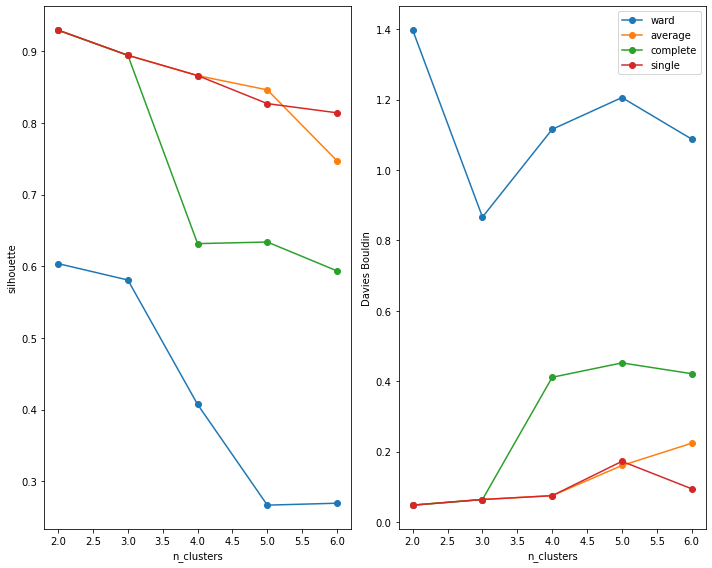

In [92]:
db_score = {}
silhouettes = {}
for linkage in ("ward", "average", "complete", "single"):
    db_score[linkage] = []
    silhouettes[linkage] = []
    for n in range(2, 7) : 
        cls = AgglomerativeClustering(n_clusters=n, affinity='euclidean', linkage=linkage)
        cls.fit(data_norm)
        silhouettes[linkage].append(metrics.silhouette_score(data_norm, cls.labels_))
        db_score[linkage].append(metrics.davies_bouldin_score(data_norm, cls.labels_))
        
fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(10,8))
for linkage in ("ward", "average", "complete", "single"):
    axs[0].plot(range(2,7), silhouettes[linkage], marker='o', label=linkage)
    axs[1].plot(range(2,7), db_score[linkage], marker='o', label=linkage)
for ax in axs :
    ax.set_xlabel("n_clusters")
axs[0].set_ylabel("silhouette")
axs[1].set_ylabel("Davies Bouldin")
plt.tight_layout()
plt.legend()
plt.show()

Le coefficient de silhouettes avec la méthode de Ward ou complete chute fortement au delà de 3 clusters.  
De même, pour l'ensemble des méthodes, le DB score montre que la valeur de 3 semble être optimale.
Il semble que 3 clusters soit la meilleure solution.


#### représentation 3D

In [46]:
for i, linkage in enumerate(["ward", "average", "complete", "single"]) :
    print("="*50)
    print(linkage)
    print('='*50)
    for j, n in enumerate([3,4]) :
        cls = AgglomerativeClustering(n_clusters=n, affinity='euclidean', linkage='ward')
        cls.fit(data_norm)
        unique, counts = np.unique(cls.labels_, return_counts=True)
        counter = dict(zip(unique, counts))
        for label in  counter:
            print(f"Nombre de clients dans le label {label} = {counter[label]}, soit {counter[label]/cls.labels_.shape[0]*100:.2f}%")
        fig = px.scatter_3d(x=data_trans[:,0], y=data_trans[:,1], z=data_trans[:,2], \
                                    color=cls.labels_, labels={'x' : "F1", 'y': 'F2', 'z' : 'F3'}, title=f"n={n}")       
        fig.show()

ward
Nombre de clients dans le label 0 = 2720, soit 94.81%
Nombre de clients dans le label 1 = 91, soit 3.17%
Nombre de clients dans le label 2 = 58, soit 2.02%


Nombre de clients dans le label 0 = 2511, soit 87.52%
Nombre de clients dans le label 1 = 91, soit 3.17%
Nombre de clients dans le label 2 = 58, soit 2.02%
Nombre de clients dans le label 3 = 209, soit 7.28%


average
Nombre de clients dans le label 0 = 2720, soit 94.81%
Nombre de clients dans le label 1 = 91, soit 3.17%
Nombre de clients dans le label 2 = 58, soit 2.02%


Nombre de clients dans le label 0 = 2511, soit 87.52%
Nombre de clients dans le label 1 = 91, soit 3.17%
Nombre de clients dans le label 2 = 58, soit 2.02%
Nombre de clients dans le label 3 = 209, soit 7.28%


complete
Nombre de clients dans le label 0 = 2720, soit 94.81%
Nombre de clients dans le label 1 = 91, soit 3.17%
Nombre de clients dans le label 2 = 58, soit 2.02%


Nombre de clients dans le label 0 = 2511, soit 87.52%
Nombre de clients dans le label 1 = 91, soit 3.17%
Nombre de clients dans le label 2 = 58, soit 2.02%
Nombre de clients dans le label 3 = 209, soit 7.28%


single
Nombre de clients dans le label 0 = 2720, soit 94.81%
Nombre de clients dans le label 1 = 91, soit 3.17%
Nombre de clients dans le label 2 = 58, soit 2.02%


Nombre de clients dans le label 0 = 2511, soit 87.52%
Nombre de clients dans le label 1 = 91, soit 3.17%
Nombre de clients dans le label 2 = 58, soit 2.02%
Nombre de clients dans le label 3 = 209, soit 7.28%


Le clustering semble plus ou moins équivalent entre tous les liens.  
De plus, d'après la visualisation, la segmentation en 4 clusters semblent permettre d'interpréter l'ensemble des clusters.  
- cluster 0 : F2 autour de 0, F1 et F3 proches de 0
- cluster 1 : F2 négatif, F1 > F1(L0), F3 faible
- cluster 2 : F2 positif, F3 faible
- cluster 3 : F2 positif, F3 grand

D'après le cercle des corrélations : 
- F1 = proportionel au montant dépensé 
- F2 = inversement proportionnel au nombre de produits / commandes
- F3 = proportionnel au nombre de commandes et à la satisfaction

On peut donc interpréter la segmentation comme :
- cluster 0 : client moyen => tous les axes proches de 0
- cluster 1 : client commandant beaucoup de produit mais avec peu de commande ou une faible satisfaction
- cluster 2 : peu de produits commandés, et peu de commande ou peu satisfait
- cluster 3 : peu de produits commandés, mais beaucoup de commande ou grande satisfaction 

La majorité des clients se trouve dans le cluster 0. 

### K-means ++

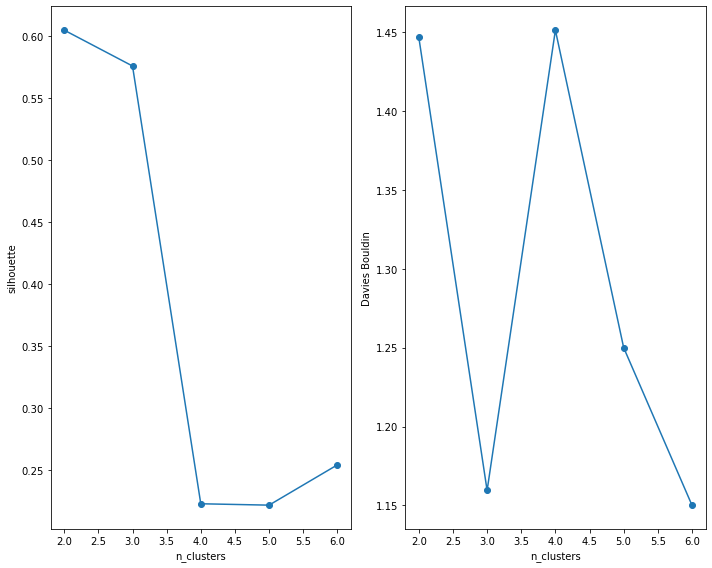

In [93]:
db_score = []
silhouettes = []
for n in range(2,7) : 
    cls = KMeans(n_clusters=n, n_init=5, init='k-means++')
    cls.fit(data_norm)
    silhouettes.append(metrics.silhouette_score(data_norm, cls.labels_))
    db_score.append(metrics.davies_bouldin_score(data_norm, cls.labels_))
fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(10,8))
axs[0].plot(range(2,7), silhouettes, marker='o')
axs[1].plot(range(2,7), db_score, marker='o')
for ax in axs :
    ax.set_xlabel("n_clusters")
axs[0].set_ylabel("silhouette")
axs[1].set_ylabel("Davies Bouldin")
plt.tight_layout()
plt.show()

La coefficient de silhouette décroit fortement lorsque le nombre de cluster est supérieur à 3.  
Cela signifie qu'il faut prévilégier un faible nombre de cluster.  
Le coefficient de Davies-Bouldin est minimum pour 3 et 6.

In [94]:
for n in [3,4] :
    print("="*20)
    print(f"n = {n}")
    print("="*20)
    cls = KMeans(n_clusters=n, n_init=5, init='k-means++')
    cls.fit(data_norm)
    unique, counts = np.unique(cls.labels_, return_counts=True)
    counter = dict(zip(unique, counts))
    for label in  counter:
        print(f"Nombre de clients dans le label {label} = {counter[label]}, soit {counter[label]/cls.labels_.shape[0]*100:.2f}%")
    fig = px.scatter_3d(x=data_trans[:,0], y=data_trans[:,1], z=data_trans[:,2], \
                                    color=cls.labels_, labels={'x' : "F1", 'y': 'F2', 'z' : 'F3'},title=f"n={n}")       
    fig.show()

n = 3
Nombre de clients dans le label 0 = 101, soit 3.52%
Nombre de clients dans le label 1 = 2673, soit 93.17%
Nombre de clients dans le label 2 = 95, soit 3.31%


n = 4
Nombre de clients dans le label 0 = 2008, soit 69.99%
Nombre de clients dans le label 1 = 679, soit 23.67%
Nombre de clients dans le label 2 = 90, soit 3.14%
Nombre de clients dans le label 3 = 92, soit 3.21%


lorsque l'on choisit 3 clusters, la clusterisation est similaire qu'avec la méthode agglomérative et une interprétation peut être facilement faite.  
Avec 4 clusters, deux clusters sont très ressemblant et il semble préférable de les aggreger.  
L'interprétation est similaire à celle faite précédemment : 
- cluster 1 : client moyen : proche de 0 sur F1, F2 et F3
- cluster 0 : F2 positif : peu de produit commandé
- cluster 2 : F2 négatif : beaucoup de produit commandé

### DBSCAN

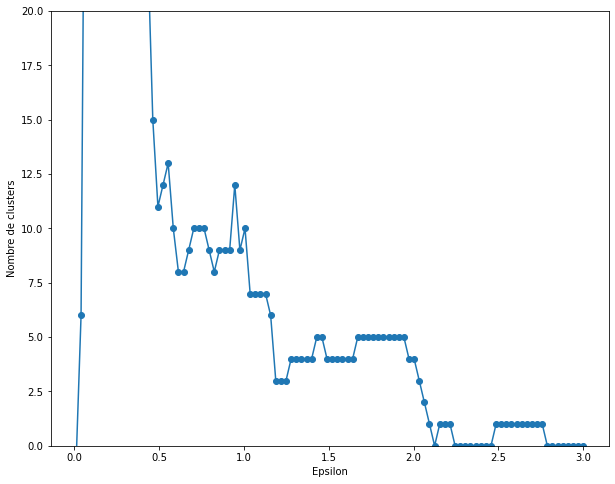

In [49]:
labels = []
for eps in np.linspace(0.01,3, 100) :
    cls = DBSCAN(eps=eps, min_samples=5, metric='euclidean', n_jobs=None)
    cls.fit(data_norm)
    labels.append(np.max(cls.labels_))

fig, ax = plt.subplots(figsize=((10,8)))
ax.plot(np.linspace(0.01,3, 100), labels, marker='o')
ax.set_ylim((0,20))
ax.set_ylabel("Nombre de clusters")
ax.set_xlabel("Epsilon")
plt.show()
#ax.scatter(data_samp_trans[:,0], data_samp_trans[:,1], c=cls.labels_)
#ax.set_xlabel("F1")
#ax.set_ylabel("F2")


Le nombre de clusters diminue plus epsilon est grand.  
Cependant la variation est n'est pas continue et il semble difficile de déterminer avec précision une distance permettant de définir un nombre de cluster.  

In [50]:
cls = DBSCAN(eps=1.5, min_samples=5, metric='euclidean', n_jobs=None)
cls.fit(data_norm)
unique, counts = np.unique(cls.labels_, return_counts=True)
counter = dict(zip(unique, counts))
for label in  counter:
    print(f"Nombre de clients dans le label {label} = {counter[label]}, soit {counter[label]/cls.labels_.shape[0]*100:.2f}%")
fig = px.scatter_3d(x=data_trans[:,0], y=data_trans[:,1], z=data_trans[:,2], \
                                    color=cls.labels_, labels={'x' : "F1", 'y': 'F2', 'z' : 'F3'})       
fig.show()

Nombre de clients dans le label -1 = 91, soit 3.17%
Nombre de clients dans le label 0 = 2585, soit 90.10%
Nombre de clients dans le label 1 = 163, soit 5.68%
Nombre de clients dans le label 2 = 18, soit 0.63%
Nombre de clients dans le label 3 = 6, soit 0.21%
Nombre de clients dans le label 4 = 6, soit 0.21%


La visualisation des clusters sur sur les premiers axes d'inerties montre une faible séparation entre chaque cluster.  
La majorité des clients sont dans le cluster "bruit".  
Cette méthode ne semble pas adaptée.

### Caractérisation des différents clusters
On applique les segmentations sur l'ensemble de la base de données, pour cela il faut préparer les données :

#### préparation des données

In [51]:
DATA['days_orders'] = DATA["order_purchase_timestamp"].apply(lambda x : (END-x.date()).days)

In [52]:
data_all = DATA.copy(deep=True)

In [53]:
aggr = {
    'order_id' : lambda x : len(x.unique()), #Nombre de commande sur la période
    'days_orders' : lambda x : x.min(), #nombre de jour depuis la dernière commande
    'price' : ['sum', 'mean'],
    #'price' :[lambda x : x.sum(), lambda x : x.mean()], # montant total dépensé et montant moyen d'un article
    'product_id' : lambda x : len(x) #Nombre d'articles commandé
}

In [54]:
data_all = DATA.groupby("customer_unique_id").agg(aggr)
data_all.rename(columns={"order_id": "n_orders"}, inplace=True)
col = ["n_orders", "n_days_last_order", 'total_price', 'product_mean_price', "n_products"]
data_all.columns = col

In [55]:
data_all

,n_orders,n_days_last_order,total_price,product_mean_price,n_products
customer_unique_id,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,116,129.90,129.90,1
0000b849f77a49e4a4ce2b2a4ca5be3f,1,119,18.90,18.90,1
0000f46a3911fa3c0805444483337064,1,542,69.00,69.00,1
0000f6ccb0745a6a4b88665a16c9f078,1,326,25.99,25.99,1
0004aac84e0df4da2b147fca70cf8255,1,293,180.00,180.00,1
...,...,...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,1,452,1570.00,785.00,2
fffea47cd6d3cc0a88bd621562a9d061,1,267,64.89,64.89,1
ffff371b4d645b6ecea244b27531430a,1,573,89.90,89.90,1


In [56]:
aggr_2 = {
    'price' : 'sum', #montant dépensé par commande
    'product_id': lambda x : len(x), #Nombre de produits par commande
    'review_score' : 'mean' #note par commande
}

In [57]:
data_tmp = DATA.groupby(['customer_unique_id', 'order_id']).agg(aggr_2)

In [58]:
aggr_3 = {
    'price' : 'mean', #prix moyen dépensé par commande
    'product_id': 'mean', #Nombre de produit moyen commandé
    'review_score' : 'mean' #Satisfaction moyenne
}

In [59]:
data_tmp = data_tmp.groupby("customer_unique_id").agg(aggr_3)
data_tmp.columns = ['mean_order_price', 'mean_n_products', 'mean_review_score']

In [60]:
data_all = pd.concat([data_all, data_tmp], axis=1)

#### Normalisation
on utilise le même scaler que précédemment.  
On applique également l'ACP précédent.

In [61]:
data_all_norm = std_scale.transform(data_all)
data_all_trans = pca.transform(data_all_norm)

#### AgglomérativeClustering
Cet algorithme ne possède pas de fonction "predict" et il est impossible de réaliser la classification sur l'ensemble des données.  
De ce fait on caractérise les clusters uniquement avec les clients ayant réalisés plus de une commande.

In [62]:
data

,n_orders,n_days_last_order,total_price,product_mean_price,n_products,mean_order_price,mean_n_products,mean_review_score
customer_unique_id,,,,,,,,
004288347e5e88a27ded2bb23747066c,2,232,317.89,158.945000,2,158.945000,1.0,5.000000
004b45ec5c64187465168251cd1c9c2f,2,100,86.90,43.450000,2,43.450000,1.0,3.000000
0058f300f57d7b93c477a131a59b36c3,2,165,132.48,66.240000,2,66.240000,1.0,3.000000
00a39521eb40f7012db50455bf083460,2,92,81.45,40.725000,2,40.725000,1.0,4.000000
00cc12a6d8b578b8ebd21ea4e2ae8b27,2,531,99.80,49.900000,2,49.900000,1.0,4.000000
...,...,...,...,...,...,...,...,...
ff22e30958c13ffe219db7d711e8f564,2,0,290.00,145.000000,2,145.000000,1.0,1.000000
ff44401d0d8f5b9c54a47374eb48c1b8,2,472,39.80,19.900000,2,19.900000,1.0,3.000000
ff8892f7c26aa0446da53d01b18df463,2,281,277.95,138.975000,2,138.975000,1.0,3.250000


In [63]:
cls_agg = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage='ward')
cls_agg.fit(data_norm)

AgglomerativeClustering(n_clusters=4)

n_orders


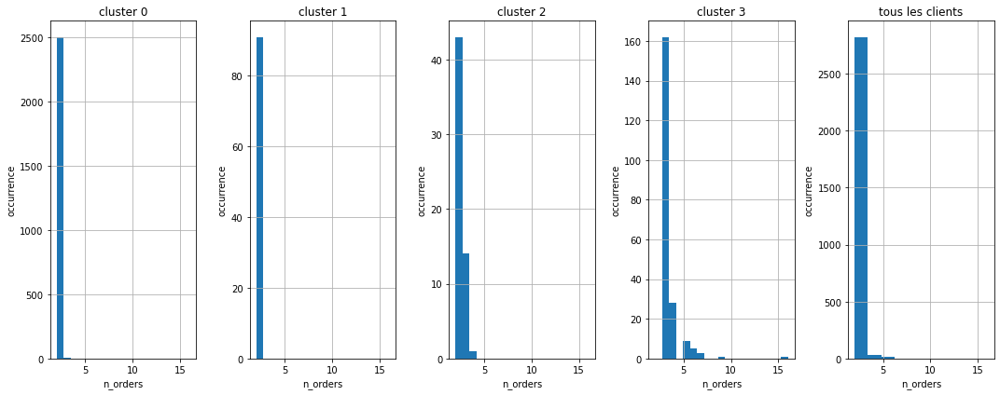

  cluster      mean       std
0     0.0  2.003982  0.062994
1     1.0  2.000000  0.000000
2     2.0  2.275862  0.488216
3     3.0  3.440191  1.243256
4     all  2.113977  0.509919
n_days_last_order


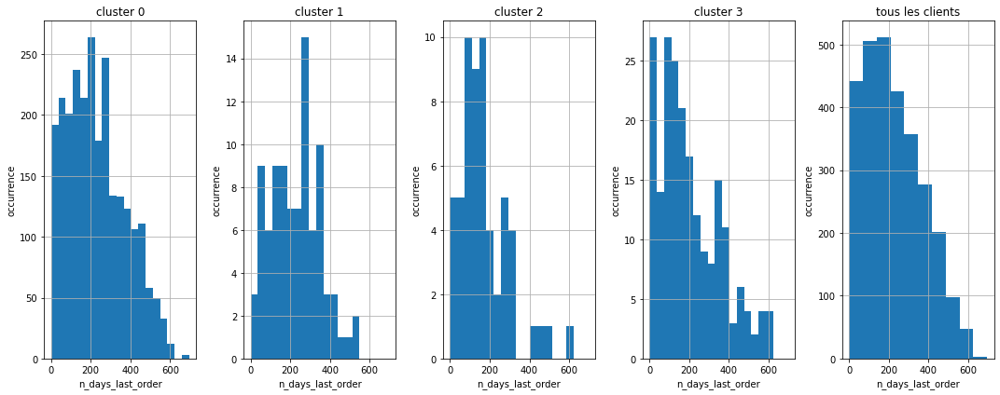

  cluster        mean         std
0     0.0  229.577061  145.287475
1     1.0  225.252747  122.718340
2     2.0  170.913793  119.398681
3     3.0  204.440191  151.899345
4     all  226.422795  144.945371
total_price


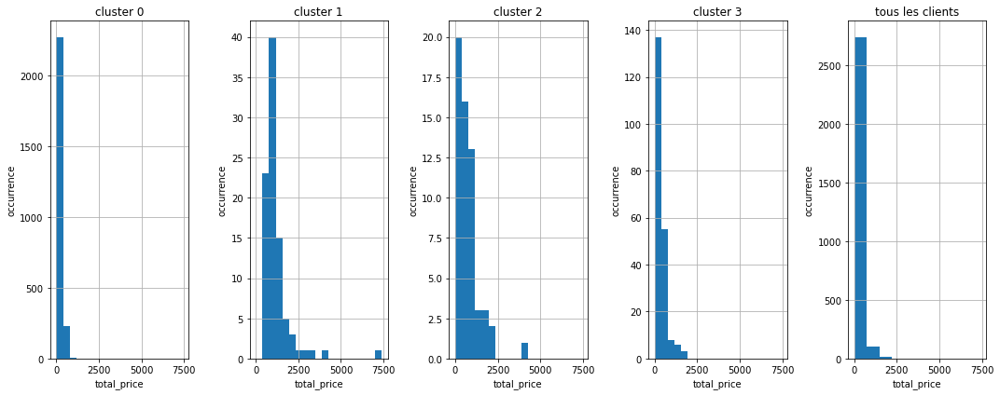

  cluster         mean         std
0     0.0   205.725090  138.141516
1     1.0  1212.369231  868.718622
2     2.0   733.049310  694.384389
3     3.0   387.720478  314.062590
4     all   261.572583  306.902522
n_products


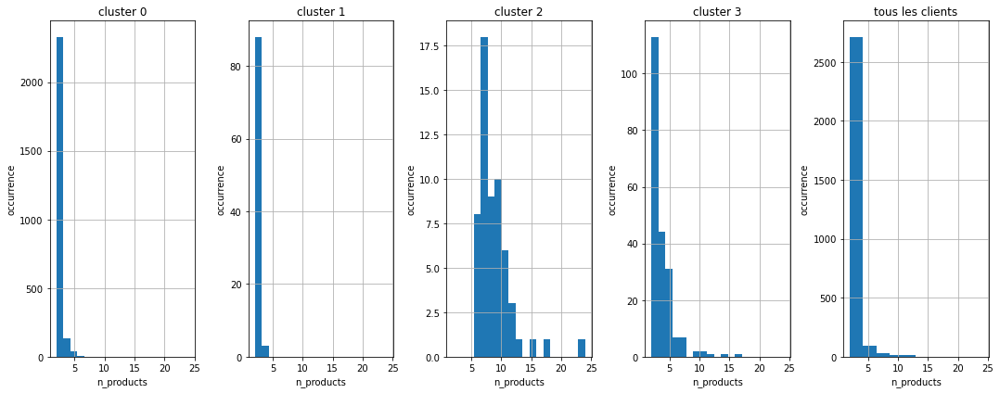

  cluster      mean       std
0     0.0  2.311031  0.668615
1     1.0  2.186813  0.469328
2     2.0  8.827586  3.146359
3     3.0  4.033493  1.822358
4     all  2.564308  1.359068
mean_review_score


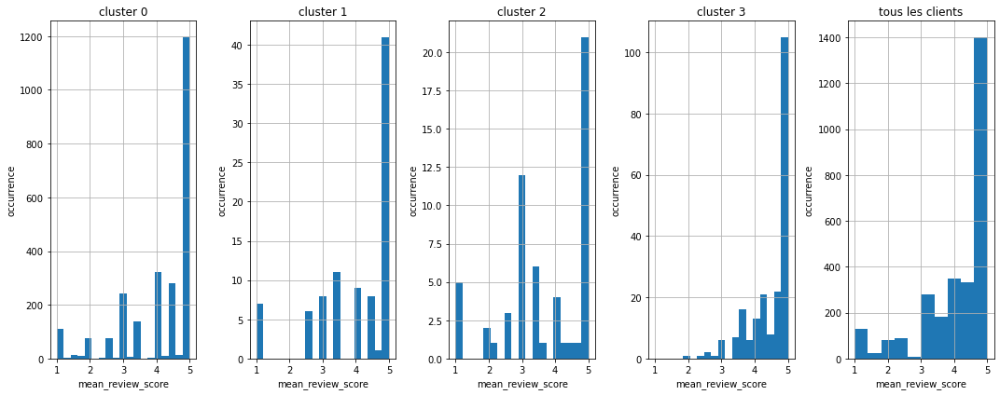

  cluster      mean       std
0     0.0  4.142639  1.122809
1     1.0  4.024725  1.205344
2     2.0  3.686782  1.270860
3     3.0  4.504944  0.653093
4     all  4.156076  1.107242


In [64]:
for param in ["n_orders", 'n_days_last_order', 'total_price', 'n_products', 'mean_review_score'] :
    print("="*50)
    print(param)
    print("="*50)
    stat = pd.DataFrame(columns=["cluster", 'mean', 'std'])
    bins = np.linspace(data[param].min(), data[param].max(), 20)
    fig, axs = plt.subplots(ncols=5, nrows=1, figsize=(15,6), sharex=True)
    for i, lab in enumerate(np.unique(cls_agg.labels_)) :
        data[cls_agg.labels_ == lab][param].hist(ax=axs[i], bins=bins)
        mean = data[cls_agg.labels_ == lab][param].mean()
        std = data[cls_agg.labels_ == lab][param].std()
        stat = stat.append({"cluster": lab, "mean":mean, "std": std}, ignore_index=True)
        axs[i].set_title(f"cluster {i}")
        axs[i].set_xlabel(param)
        axs[i].set_ylabel("occurrence")
    data[param].hist(ax=axs[-1])
    axs[-1].set_title("tous les clients")
    axs[-1].set_xlabel(param)
    axs[-1].set_ylabel("occurrence")
    mean = data[param].mean()
    std = data[param].std()
    stat = stat.append({"cluster": "all", "mean":mean, "std": std}, ignore_index=True)
    plt.tight_layout()
    plt.show()
    print(stat)
    #data[param].hist(ax=axs[0])


##### interprétation : 
- Cluster 0 : client moyen, dépensant peu
- Cluster 1 : client dépensant beaucoup
- Cluster 2 : client ayant commandé récemment, dépensant beaucoup (quantité + montant)
- Cluster 3 : client commandant régulièrement, un nombre important d’articles et plutôt satisfait.

In [95]:
dat = DATA[DATA["customer_unique_id"].isin(data.index)]
dat = dat.drop_duplicates(subset="customer_unique_id")
px.set_mapbox_access_token(open(".mapbox_token.txt").read())

fig = px.scatter_mapbox(dat[["geolocation_lat", "geolocation_lng"]],
                        lat=dat["geolocation_lat"],
                        lon=dat["geolocation_lng"],
                        color=cls_agg.labels_,
                        zoom=1)
fig.show()

Aucune tendance géographique ne semble pouvoir être extraite. 

#### KMEANS

In [66]:
cls_kmeans = KMeans(n_clusters=3, n_init=5, init='k-means++')
cls_kmeans.fit(data_norm)
pred_kmeans = cls_kmeans.predict(data_all_norm)

In [96]:
unique, counts = np.unique(pred_kmeans, return_counts=True)
counter = dict(zip(unique, counts))
for label in  counter:
    print(f"Nombre de clients dans le label {label} = {counter[label]}, soit {counter[label]/pred_kmeans.shape[0]*100:.2f}%")
fig = px.scatter_3d(x=data_all_trans[:,0], y=data_all_trans[:,1], z=data_all_trans[:,2], \
                    color=pred_kmeans, labels={'x' : "F1", 'y': 'F2', 'z' : 'F3'})       
fig.show()

Nombre de clients dans le label 0 = 4098, soit 4.33%
Nombre de clients dans le label 1 = 89703, soit 94.70%
Nombre de clients dans le label 2 = 920, soit 0.97%


n_orders


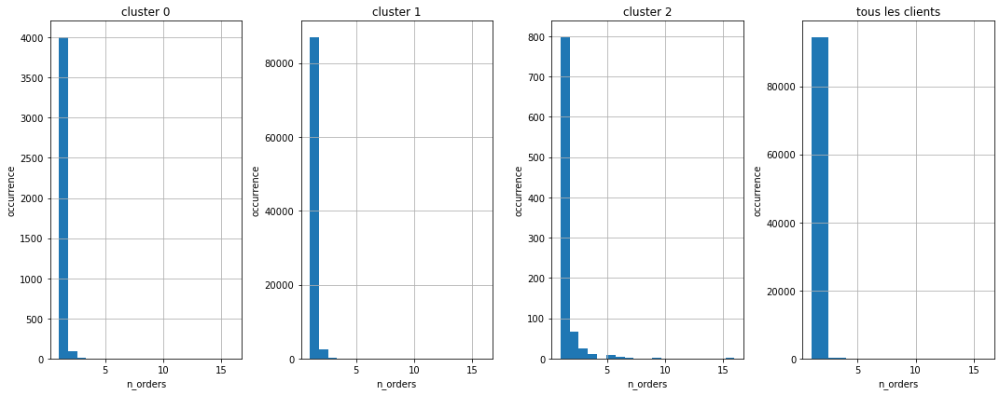

  cluster      mean       std
0     0.0  1.024158  0.165788
1     1.0  1.031716  0.187951
2     2.0  1.273913  0.969039
3     all  1.033741  0.210527
n_days_last_order


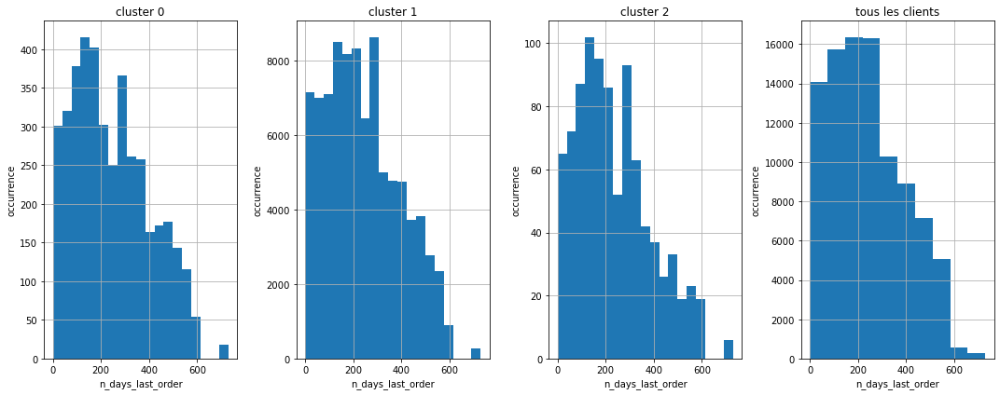

  cluster        mean         std
0     0.0  245.365544  156.398738
1     1.0  243.320524  153.024392
2     2.0  236.626087  152.915971
3     all  243.343979  153.171229
total_price


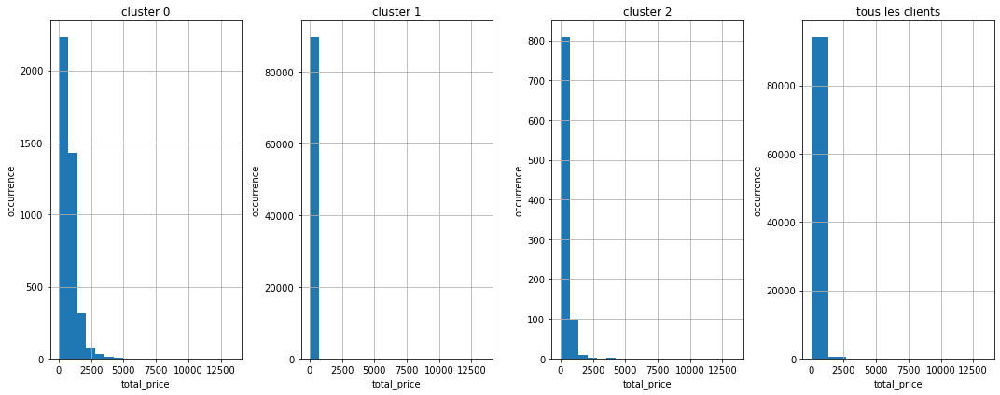

  cluster        mean         std
0     0.0  862.853404  581.127160
1     1.0  107.065383   86.640571
2     2.0  355.310543  331.624276
3     all  142.174861  216.476901
n_products


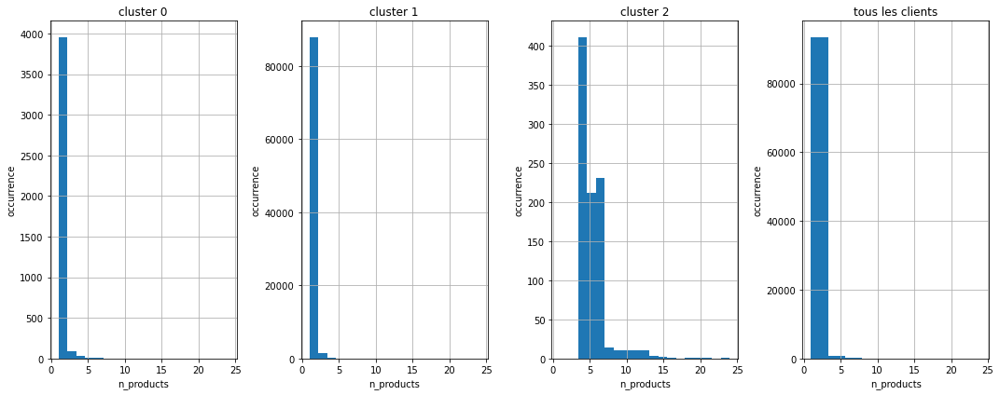

  cluster      mean       std
0     0.0  1.162518  0.557585
1     1.0  1.138011  0.412474
2     2.0  5.283696  2.022441
3     all  1.179337  0.616039
mean_review_score


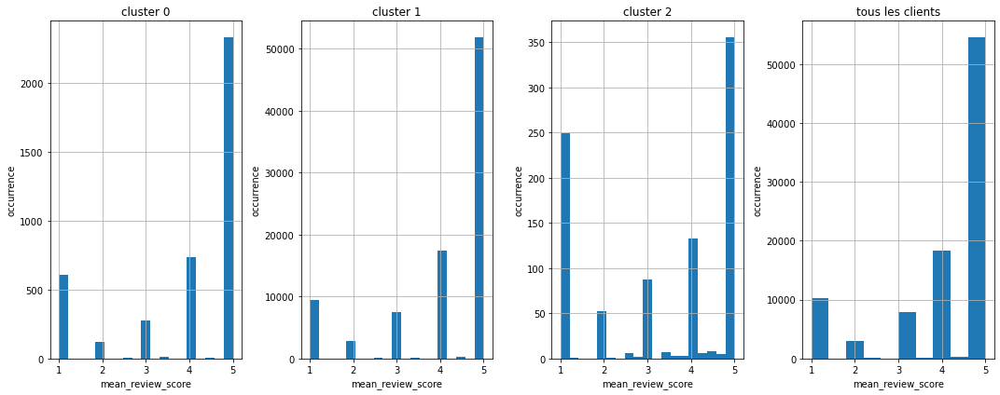

  cluster      mean       std
0     0.0  3.996685  1.446547
1     1.0  4.115007  1.314306
2     2.0  3.353146  1.662904
3     all  4.102488  1.326391


In [68]:
for param in ["n_orders", 'n_days_last_order', 'total_price', 'n_products', 'mean_review_score'] :
    print("="*50)
    print(param)
    print("="*50)
    stat = pd.DataFrame(columns=["cluster", 'mean', 'std'])
    bins = np.linspace(data_all[param].min(), data_all[param].max(), 20)
    fig, axs = plt.subplots(ncols=4, nrows=1, figsize=(15,6), sharex=True)
    for i, lab in enumerate(np.unique(pred_kmeans)) :
        data_all[ pred_kmeans== lab][param].hist(ax=axs[i], bins=bins)
        mean = data_all[pred_kmeans == lab][param].mean()
        std = data_all[pred_kmeans == lab][param].std()
        stat = stat.append({"cluster": lab, "mean":mean, "std": std}, ignore_index=True)
        axs[i].set_title(f"cluster {i}")
        axs[i].set_xlabel(param)
        axs[i].set_ylabel("occurrence")
    data_all[param].hist(ax=axs[-1])
    axs[-1].set_title("tous les clients")
    axs[-1].set_xlabel(param)
    axs[-1].set_ylabel("occurrence")
    mean = data_all[param].mean()
    std = data_all[param].std()
    stat = stat.append({"cluster": "all", "mean":mean, "std": std}, ignore_index=True)
    plt.tight_layout()
    plt.show()
    print(stat)

##### interprétation : 
- Cluster 0 : Client dépensant beaucoup 
- Cluster 1 : client moyen, dépensant peu
- Cluster 2 : client ayant commandé plus régulièrement, plus de produits, pour un montant plus élevé

In [97]:
dat = DATA[DATA["customer_unique_id"].isin(data_all.index)]
dat = dat.drop_duplicates(subset="customer_unique_id")
px.set_mapbox_access_token(open(".mapbox_token.txt").read())

fig = px.scatter_mapbox(dat[["geolocation_lat", "geolocation_lng"]],
                        lat=dat["geolocation_lat"],
                        lon=dat["geolocation_lng"],
                        color=pred_kmeans,
                        zoom=1)
fig.show()

La segmentation ne met pas en évidence une segmentation géographique.